In [1]:
import numpy as np
import pandas as pd
import folium
from folium import plugins
import geopandas as gpd
import seaborn as sns
import matplotlib.pyplot as plt
import random
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.linear_model import LinearRegression, LogisticRegression
from sklearn.ensemble import RandomForestRegressor, RandomForestClassifier
import statsmodels.api as sm
from sklearn.metrics import roc_auc_score,accuracy_score, f1_score


from sklearn.cluster import KMeans, AgglomerativeClustering, Birch
from sklearn.metrics import silhouette_score
from itertools import combinations
center = (37.1623799231016, 127.05436890115905)
plt.style.use(['ggplot'])
rs = 123
np.random.seed(rs)
random.seed(rs)

In [2]:
data25 = pd.read_csv("data/feature25.csv")
data50 = pd.read_csv("data/feature50.csv")

# 선정 지점 시각화

In [3]:
def draw_map(point_data):
    # map
    map1 = folium.Map(location=center, zoom_start=13, control_scale=True)

    # all subgroups
    all_subgroups = folium.FeatureGroup(name='all_thing')
    map1.add_child(all_subgroups)

    #osan
    osan_region = plugins.FeatureGroupSubGroup(all_subgroups, 'osan region')
    map1.add_child(osan_region)
    osan = gpd.read_file('../data/original/33.오산시_법정경계(읍면동).geojson',encoding="utf-8")
    folium.GeoJson(osan, style_function=lambda x:{'fillColor': 'transparent', 'color': 'grey'}).add_to(osan_region)

    road_data = gpd.read_file('../data/original/23.오산시_상세도로망_LV6.geojson',encoding="utf-8")
    road_data = road_data[road_data["road_name"].apply(lambda x: "고속도로" not in str(x))].reset_index(drop = True)
    road = plugins.FeatureGroupSubGroup(all_subgroups, 'road')
    map1.add_child(road)
    folium.GeoJson(road_data, style_function=lambda x:{'fillColor': 'transparent', "weight": int(x["properties"]["width"]) ** 1.5 / 2, 'color': 'black'}).add_to(road)

    # point
    check_point = plugins.FeatureGroupSubGroup(all_subgroups, 'check_point')
    map1.add_child(check_point)
    if "color" in point_data:
        for i in range(0, len(point_data)):
            folium.Circle(
                location = [point_data.loc[i,"lat"],
                            point_data.loc[i,"lon"]],
                radius = 1,
                color = point_data.loc[i,"color"],
                fillColor = point_data.loc[i,"color"],
                tooltip=str((point_data.loc[i,"lon"], point_data.loc[i,"lat"])),
            ).add_to(check_point)
    else:
        for i in range(0, len(point_data)):
            folium.Circle(
                location = [point_data.loc[i,"lat"],
                            point_data.loc[i,"lon"]],
                radius = 1,
                color = "red",
                fillColor = "red",
                tooltip=str((point_data.loc[i,"lon"], point_data.loc[i,"lat"])),
            ).add_to(check_point)


    folium.LayerControl(collapsed=False).add_to(map1)
    return map1


In [4]:
draw_map(data50)

# 회귀, 분류 분석

In [5]:
data25['is_bump20'] = data25['shortest_bump_dist'] < 20
data50['is_bump40'] = data50['shortest_bump_dist'] < 40

data25['is_sidewalk12.5'] = data25['shortest_sidewalk_dist'] < 12.5
data50['is_sidewalk25'] = data50['shortest_sidewalk_dist'] < 25

col = {"x_common": ['overspeed_cam_count100', 'floating_pop_count50','car_count1000', 'child_count1000', 
                  'elem_kinder_count400','num_cram_school_count400', 
                  'shortest_cross_dist','shortest_traffic_signal_dist',], # 'numberSchoolZone_count400'
       "x_25" : ['is_bump20', 'parking_count12.5','is_sidewalk12.5', 'barrier_nearby_count12.5',
                   'chaos1_nearby_count12.5', 'width_nearby_count12.5','cross_road_nearby_count12.5',
                   ],
       "x_50" : ['is_bump40', 'parking_count25','is_sidewalk25', 'barrier_nearby_count25',
                   'chaos1_nearby_count25', 'width_nearby_count25','cross_road_nearby_count25'],
       "y_25" : 'accident_count12.5',
       "y_50" : 'accident_count25',}

## 회귀

### x,y데이터 준비

In [6]:
xy25 = data25[col["x_common"] + col["x_25"] +[col['y_25']]].astype(float)
xy50 = data50[col["x_common"] + col["x_50"] +[col['y_50']]].astype(float)


# fit_transform -> 한꺼번에 가능
scaler = MinMaxScaler()
xy50.loc[:,:] = scaler.fit_transform(xy50)
xy25.loc[:,:] = scaler.transform(xy25)

x50, y50 = xy50.iloc[:,:-1], xy50.iloc[:,-1]
x25, y25 = xy25.iloc[:,:-1], xy25.iloc[:,-1]


### RandomForestRegressor

In [7]:
rf = RandomForestRegressor()
rf.fit(x50, y50)
rf.score(x25, y25)

-0.28027812663212814

## classification


### 기본

In [8]:
xy25 = data25[col["x_common"] + col["x_25"] +[col['y_25']]].astype(float)
xy50 = data50[col["x_common"] + col["x_50"] +[col['y_50']]].astype(float)
xy25[col['y_25']] = (xy25[col['y_25']] > 0).astype(float)
xy50[col['y_50']] = (xy50[col['y_50']] > 0).astype(float)

# fit_transform -> 한꺼번에 가능
scaler = MinMaxScaler()
xy50.loc[:,:] = scaler.fit_transform(xy50)
xy25.loc[:,:] = scaler.transform(xy25)


x50, y50 = xy50.iloc[:,:-1], xy50.iloc[:,-1]
x25, y25 = xy25.iloc[:,:-1], xy25.iloc[:,-1]

model = sm.Logit(y50,sm.add_constant(x50,has_constant = "add"))
results = model.fit(method= 'lbfgs',maxiter =1000)


predictions = results.predict(sm.add_constant(x25,has_constant = "add"))
print("auc_roc:", roc_auc_score(y25.astype(int),predictions))
print("accuracy:",accuracy_score(y25.astype(int),predictions.apply(lambda x: 0 if x <0.5 else 1)))
print("f1:",f1_score(y25.astype(int),predictions.apply(lambda x: 0 if x <0.5 else 1)))

results.summary2()

auc_roc: 0.7769096378691862
accuracy: 0.9743321110529073
f1: 0.0


<class 'statsmodels.iolib.summary2.Summary'>
"""
                               Results: Logit
=============================================================================
Model:                  Logit                Pseudo R-squared:     0.144     
Dependent Variable:     accident_count25     AIC:                  1554.0117 
Date:                   2021-01-24 17:32     BIC:                  1654.3606 
No. Observations:       3912                 Log-Likelihood:       -761.01   
Df Model:               15                   LL-Null:              -888.67   
Df Residuals:           3896                 LLR p-value:          9.9343e-46
Converged:              1.0000               Scale:                1.0000    
No. Iterations:         66.0000                                              
-----------------------------------------------------------------------------
                              Coef.  Std.Err.    z    P>|z|   [0.025   0.975]
-----------------------------------------------------------------------------
const                        -3.6859   0.4612 -7.9925 0.0000  -4.5898 -2.7821
overspeed_cam_count100        0.5095   0.4373  1.1652 0.2440  -0.3476  1.3665
floating_pop_count50          1.3014   0.5294  2.4581 0.0140   0.2637  2.3391
car_count1000                -0.3807   0.5208 -0.7310 0.4648  -1.4015  0.6401
child_count1000              -0.4758   0.3338 -1.4255 0.1540  -1.1300  0.1784
elem_kinder_count400          2.1221   0.4018  5.2810 0.0000   1.3345  2.9097
num_cram_school_count400      1.1800   0.3476  3.3947 0.0007   0.4987  1.8613
shortest_cross_dist          -8.4154   3.1515 -2.6703 0.0076 -14.5922 -2.2386
shortest_traffic_signal_dist -2.6243   1.9716 -1.3310 0.1832  -6.4886  1.2401
is_bump40                     0.0565   0.6178  0.0915 0.9271  -1.1544  1.2675
parking_count25               2.4890   1.0716  2.3228 0.0202   0.3888  4.5892
is_sidewalk25                 0.1654   0.1843  0.8973 0.3696  -0.1959  0.5267
barrier_nearby_count25       -0.3209   0.1920 -1.6714 0.0946  -0.6973  0.0554
chaos1_nearby_count25         0.5058   0.2781  1.8183 0.0690  -0.0394  1.0509
width_nearby_count25          0.7597   0.3413  2.2258 0.0260   0.0907  1.4287
cross_road_nearby_count25     2.0983   0.5389  3.8938 0.0001   1.0421  3.1545
=============================================================================

"""

<AxesSubplot:xlabel='x', ylabel='effect'>

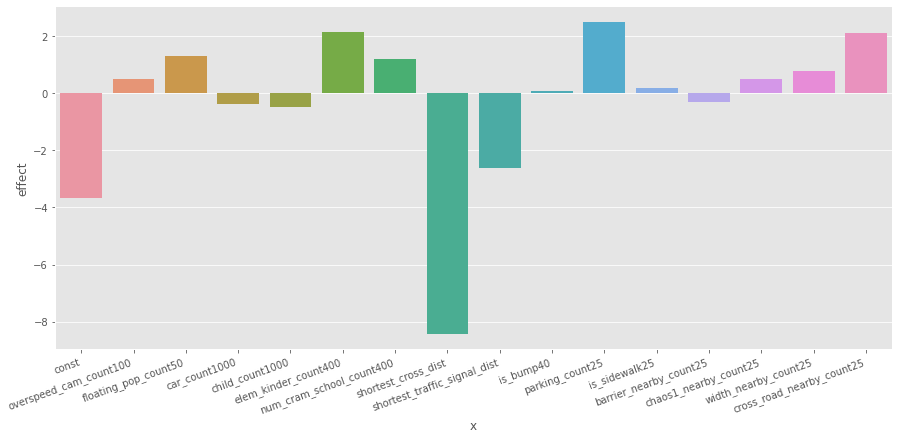

In [9]:
fig,ax = plt.subplots(figsize = (15,7))
# plt.xticks(rotation =30)
tmp = pd.DataFrame(results.params.to_frame().reset_index().values, columns = ["x", "effect"])
fig.autofmt_xdate(rotation=20)
sns.barplot(data = tmp, x = "x", y = "effect",ax = ax)

## 사고 방지 시설 + p-value 기반 feature drop

In [10]:
dup = ["numberSchoolZone_count400"]
protection = ["barrier_nearby_count12.5", "barrier_nearby_count25", "shortest_cross_dist",
             "overspeed_cam_count100",  "shortest_traffic_signal_dist","is_bump40","is_bump20", 
              "is_sidewalk12.5", "is_sidewalk25",]
p_value = ["car_count1000", "child_count1000", "chaos1_nearby_count12.5", "chaos1_nearby_count25"]
del_col = protection + p_value + dup
xy25 = data25[col["x_common"] + col["x_25"] +[col['y_25']]].astype(float)
xy50 = data50[col["x_common"] + col["x_50"] +[col['y_50']]].astype(float)
xy25[col['y_25']] = (xy25[col['y_25']] > 0).astype(float)
xy50[col['y_50']] = (xy50[col['y_50']] > 0).astype(float)

# fit_transform -> 한꺼번에 가능
scaler = MinMaxScaler()
xy50.loc[:,:] = scaler.fit_transform(xy50)
xy25.loc[:,:] = scaler.transform(xy25)


x50, y50 = xy50.iloc[:,:-1], xy50.iloc[:,-1]
x25, y25 = xy25.iloc[:,:-1], xy25.iloc[:,-1]
x50 = x50.loc[:,~np.isin(x50.columns,del_col)]
x25 = x25.loc[:,~np.isin(x25.columns,del_col)]


model = sm.Logit(y50,sm.add_constant(x50,has_constant = "add"))
results = model.fit(method= 'lbfgs',maxiter =1000)
predictions = results.predict(sm.add_constant(x25,has_constant = "add"))
print("auc_roc:", roc_auc_score(y25.astype(int),predictions))
print("accuracy:",accuracy_score(y25.astype(int),predictions.apply(lambda x: 0 if x <0.5 else 1)))
print("f1:",f1_score(y25.astype(int),predictions.apply(lambda x: 0 if x <0.5 else 1)))

results.summary2()

auc_roc: 0.7534050772056416
accuracy: 0.9742011524358303
f1: 0.0


<class 'statsmodels.iolib.summary2.Summary'>
"""
                              Results: Logit
==========================================================================
Model:                  Logit               Pseudo R-squared:    0.123    
Dependent Variable:     accident_count25    AIC:                 1558.7823
Date:                   2021-01-24 17:32    BIC:                 1558.7823
No. Observations:       3912                Log-Likelihood:      -779.39  
Df Model:               -1                  LL-Null:             -888.67  
Df Residuals:           3912                LLR p-value:         nan      
Converged:              1.0000              Scale:               1.0000   
No. Iterations:         25.0000                                           
--------------------------------------------------------------------------
                           Coef.  Std.Err.    z     P>|z|   [0.025  0.975]
--------------------------------------------------------------------------
const                     -4.3438   0.1936 -22.4426 0.0000 -4.7232 -3.9645
floating_pop_count50       2.0908   0.4942   4.2308 0.0000  1.1222  3.0594
elem_kinder_count400       2.4243   0.3687   6.5758 0.0000  1.7017  3.1469
num_cram_school_count400   1.2915   0.3446   3.7475 0.0002  0.6160  1.9670
parking_count25            3.2070   1.0670   3.0056 0.0027  1.1157  5.2983
width_nearby_count25       0.6529   0.2715   2.4052 0.0162  0.1209  1.1850
cross_road_nearby_count25  2.2230   0.4907   4.5301 0.0000  1.2612  3.1848
==========================================================================

"""

<AxesSubplot:xlabel='x', ylabel='effect'>

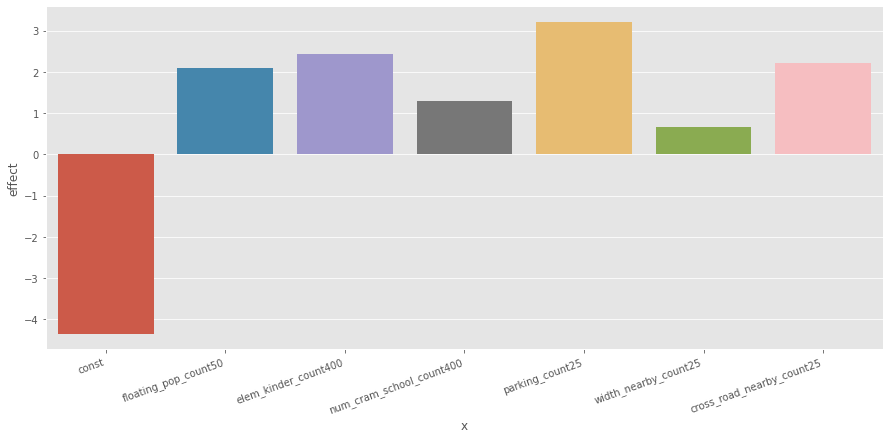

In [11]:

fig,ax = plt.subplots(figsize = (15,7))
# plt.xticks(rotation =30)
base_coef = pd.DataFrame(results.params.to_frame().reset_index().values, columns = ["x", "effect"])
fig.autofmt_xdate(rotation=20)
sns.barplot(data = base_coef, x = "x", y = "effect",ax = ax)

## sklearn 이용

In [12]:
xy25 = data25[col["x_common"] + col["x_25"] +[col['y_25']]].astype(float)
xy50 = data50[col["x_common"] + col["x_50"] +[col['y_50']]].astype(float)
xy25[col['y_25']] = (xy25[col['y_25']] > 0).astype(float)
xy50[col['y_50']] = (xy50[col['y_50']] > 0).astype(float)

# fit_transform -> 한꺼번에 가능
scaler = MinMaxScaler()
xy50.loc[:,:] = scaler.fit_transform(xy50)
xy25.loc[:,:] = scaler.transform(xy25)


x50, y50 = xy50.iloc[:,:-1], xy50.iloc[:,-1]
x25, y25 = xy25.iloc[:,:-1], xy25.iloc[:,-1]


lr = LogisticRegression(max_iter = 1000)
lr.fit(x50, y50)
print(lr.score(x25, y25),f1_score(y25,lr.predict(x25)))


# fig,ax = plt.subplots(figsize = (15,15))
# tmp = pd.DataFrame(list(zip(list(x50.columns),rf.coef_[0])), columns = ["x", "effect"])
# fig.autofmt_xdate(rotation=20)
# sns.barplot(data = tmp, x = "x", y = "effect",ax = ax)

0.9743321110529073 0.0


shortest_traffic_signal_dist, shortest_cross_dist boolean으로 바꿈

In [13]:
xy25 = data25[col["x_common"] + col["x_25"] +[col['y_25']]].astype(float)
xy50 = data50[col["x_common"] + col["x_50"] +[col['y_50']]].astype(float)
xy25[col['y_25']] = (xy25[col['y_25']] > 0).astype(float)
xy50[col['y_50']] = (xy50[col['y_50']] > 0).astype(float)

xy25["shortest_traffic_signal_dist"]= xy25["shortest_traffic_signal_dist"] < 12.5
xy50["shortest_traffic_signal_dist"]= xy50["shortest_traffic_signal_dist"] < 25
xy25.rename(columns = {"shortest_traffic_signal_dist" : "is_traffic_signal12.5"},inplace = True)
xy50.rename(columns = {"shortest_traffic_signal_dist" : "is_traffic_signal25"},inplace = True)

xy25["shortest_cross_dist"]= xy25["shortest_cross_dist"] < 12.5
xy50["shortest_cross_dist"]= xy50["shortest_cross_dist"] < 25
xy25.rename(columns = {"shortest_cross_dist" : "is_cross12.5"},inplace = True)
xy50.rename(columns = {"shortest_cross_dist" : "is_cross25"},inplace = True)


scaler = MinMaxScaler()
xy50.loc[:,:] = scaler.fit_transform(xy50)
xy25.loc[:,:] = scaler.transform(xy25)

x50, y50 = xy50.iloc[:,:-1], xy50.iloc[:,-1]
x25, y25 = xy25.iloc[:,:-1], xy25.iloc[:,-1]

lr = LogisticRegression(max_iter = 1000)
lr.fit(x50, y50)
print(lr.score(x25, y25),f1_score(y25,lr.predict(x25)))


# fig,ax = plt.subplots(figsize = (15,15))
# tmp = pd.DataFrame(list(zip(list(x50.columns),rf.coef_[0])), columns = ["x", "effect"])
# fig.autofmt_xdate(rotation=20)
# sns.barplot(data = tmp, x = "x", y = "effect",ax = ax)

0.9735463593504453 0.00980392156862745


# 클러스터링

In [14]:
xy25 = data25[col["x_common"] + col["x_25"] +[col['y_25']]].astype(float)
xy50 = data50[col["x_common"] + col["x_50"] +[col['y_50']]].astype(float)
# xy25[col['y_25']] = (xy25[col['y_25']] > 1).astype(float)
# xy50[col['y_50']] = (xy50[col['y_50']] > 1).astype(float)
# fit_transform -> 한꺼번에 가능
scaler = MinMaxScaler()
xy25.loc[:,:] = scaler.fit_transform(xy25)
# xy25.loc[:,:] = scaler.transform(xy25)

In [15]:
# del_col = protection + p_value + dup
# xy25 = data25[col["x_common"] + col["x_25"] +[col['y_25']]].astype(float)

# scaler = MinMaxScaler()

# xy25.loc[:,:] = scaler.fit_transform(xy25)
# xy25 = xy25.loc[:,~np.isin(xy25.columns,del_col)]

# x50, y50 = xy50.iloc[:,:-1], xy50.iloc[:,-1]
# x25, y25 = xy25.iloc[:,:-1], xy25.iloc[:,-1]
# x50 = x50.loc[:,~np.isin(x50.columns,del_col)]
# x25 = x25.loc[:,~np.isin(x25.columns,del_col)]

In [16]:

kmeans2 = KMeans(n_clusters=2, random_state=None, max_iter= 10000).fit(xy25)
agglomer2 = AgglomerativeClustering(n_clusters=2).fit(xy25)
birch2 = Birch(n_clusters=2).fit(xy25)

kmeans3 = KMeans(n_clusters=3, random_state=None, max_iter= 10000).fit(xy25)
agglomer3 = AgglomerativeClustering(n_clusters=3).fit(xy25)
birch3 = Birch(n_clusters=3).fit(xy25)

kmeans4 = KMeans(n_clusters=4, random_state=None, max_iter= 10000).fit(xy25)
agglomer4 = AgglomerativeClustering(n_clusters=4).fit(xy25)
birch4 = Birch(n_clusters=4).fit(xy25)

kmeans5 = KMeans(n_clusters=5, random_state=None, max_iter= 10000).fit(xy25)
agglomer5 = AgglomerativeClustering(n_clusters=5).fit(xy25)
birch5 = Birch(n_clusters=5).fit(xy25)

kmeans6 = KMeans(n_clusters=6, random_state=None, max_iter= 10000).fit(xy25)
agglomer6 = AgglomerativeClustering(n_clusters=6).fit(xy25)
birch6 = Birch(n_clusters=6).fit(xy25)

for i in ["2","3","4","5","6"]:
    for clu in ["kmeans", "agglomer", "birch"]:
        print(clu+i,":", silhouette_score(xy25, eval(clu+i).labels_))
    print()

# print("kmeans4:",silhouette_score(xy25, kmeans.labels_))
# print("agglomer4:",silhouette_score(xy25, agglomer.labels_))
# print("birch4:",silhouette_score(xy25, birch.labels_))

kmeans2 : 0.3181745897137451
agglomer2 : 0.29410678466397205
birch2 : 0.31134826183041453

kmeans3 : 0.35464064908700743
agglomer3 : 0.3535418504238849
birch3 : 0.3537050877653388

kmeans4 : 0.37494543220792687
agglomer4 : 0.3737568885768981
birch4 : 0.3733298001947419

kmeans5 : 0.31825412256578756
agglomer5 : 0.30407222556431934
birch5 : 0.3745918531809651

kmeans6 : 0.2572004810540863
agglomer6 : 0.23068828688230547
birch6 : 0.36013389465683027



In [17]:

kmeans = KMeans(n_clusters=4, random_state = rs, max_iter= 10000).fit(xy25)
agglomer = AgglomerativeClustering(n_clusters=4).fit(xy25)
birch = Birch(n_clusters=4).fit(xy25)
tmp = np.concatenate([kmeans.labels_.reshape(-1,1), agglomer.labels_.reshape(-1,1), birch.labels_.reshape(-1,1)],axis=1)
tmp = pd.DataFrame(tmp,columns = ["kmeans","agglomer","birch"])

dic = {}
for i in range(4):
    index = tmp.loc[tmp["kmeans"] == i,"agglomer"].value_counts().index[0]
    dic[index] = i
tmp["agglomer"] = tmp["agglomer"].map(dic)


dic = {}
for i in range(4):
    index = tmp.loc[tmp["kmeans"] == i,"birch"].value_counts().index[0]
    dic[index] = i
tmp["birch"] = tmp["birch"].map(dic)


print((tmp["kmeans"] != tmp["agglomer"]).sum(), (tmp["kmeans"] != tmp["birch"]).sum())

10 14


<AxesSubplot:xlabel='x', ylabel='centroid'>

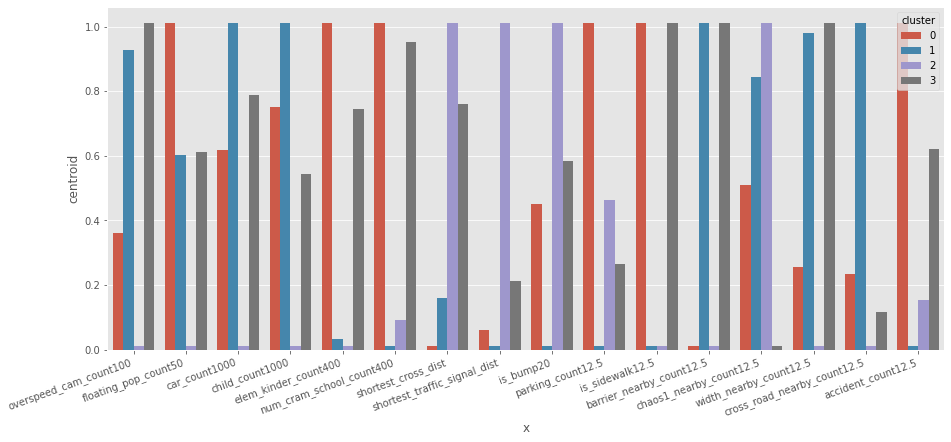

In [18]:
tmp = pd.DataFrame(kmeans.cluster_centers_,columns = xy25.columns)
tmp = ((tmp - tmp.min()) / (tmp.max() - tmp.min()) + 0.01).sort_values("accident_count12.5").reset_index()
value = []
for i in list(tmp.columns)[1:]:
    tmp_col = tmp[["index",i]].rename(columns = {"index" : "cluster", i : "centroid"})
    tmp_col["x"] = i
    value.append(tmp_col)
fig,ax = plt.subplots(figsize = (15,7))
fig.autofmt_xdate(rotation=20)
sns.barplot(data = pd.concat(value), x = "x", y = "centroid", hue = "cluster", ax=ax, )


In [19]:
tmp_predict = pd.Series(kmeans.predict(xy25)).map({0:"red",1:"blue",2:"green",3:"black"})
tmp = pd.concat([data25[['lon','lat']], tmp_predict],axis=1).rename(columns = {0:"color"})

draw_map(tmp)


## 클러스터링 바탕 classification

In [21]:
xy25 = data25[col["x_common"] + col["x_25"] +[col['y_25']]].astype(float)
xy50 = data50[col["x_common"] + col["x_50"] +[col['y_50']]].astype(float)

# fit_transform -> 한꺼번에 가능
scaler = MinMaxScaler()
xy50.loc[:,:] = scaler.fit_transform(xy50)
xy25.loc[:,:] = scaler.transform(xy25)

cluster50 = kmeans.predict(xy50)
cluster25 = kmeans.predict(xy25)

In [22]:
# pd.Series(cluster25).to_csv("data/kmeans_cluster25.csv",index=False)
# pd.Series(cluster50).to_csv("data/kmeans_cluster50.csv",index=False)

In [23]:
del_col = protection + p_value + dup
xy25 = data25[col["x_common"] + col["x_25"] +[col['y_25']]].astype(float)
xy50 = data50[col["x_common"] + col["x_50"] +[col['y_50']]].astype(float)
xy25[col['y_25']] = (xy25[col['y_25']] > 0).astype(float)
xy50[col['y_50']] = (xy50[col['y_50']] > 0).astype(float)

# fit_transform -> 한꺼번에 가능
scaler = MinMaxScaler()
xy50.loc[:,:] = scaler.fit_transform(xy50)
xy25.loc[:,:] = scaler.transform(xy25)


x50, y50 = xy50.iloc[:,:-1], xy50.iloc[:,-1]
x25, y25 = xy25.iloc[:,:-1], xy25.iloc[:,-1]
x50 = x50.loc[:,~np.isin(x50.columns,del_col)]
x25 = x25.loc[:,~np.isin(x25.columns,del_col)]

for j in [1,2,3,4]:
    for i in list(combinations([0,1,2,3],j)):
        index_bool50 = np.isin(cluster50,i)
        index_bool25 = np.isin(cluster25,i)
        print(format(str(i),"13"),": length25","(",format(index_bool25.sum(),"4"),", ",format(index_bool25.mean() * 100,"6.2f"), "%)",
              ", length50","(",format(index_bool50.sum(),"4"),", ",format(index_bool50.mean() * 100,"6.2f"), "%)",sep="",end="")
        tmp_x50, tmp_y50 = x50[index_bool50], y50[index_bool50]
        tmp_x25, tmp_y25 = x25[index_bool25], y25[index_bool25]
        
        model = sm.Logit(tmp_y50,sm.add_constant(tmp_x50,has_constant = "add"))
        results = model.fit(method= 'lbfgs',maxiter =1000)
        predictions = results.predict(sm.add_constant(tmp_x25,has_constant = "add"))
        
        auc_roc = roc_auc_score(tmp_y25.astype(int),predictions)
        accuracy = accuracy_score(tmp_y25.astype(int),predictions.apply(lambda x: 0 if x <0.5 else 1))
        f1 = f1_score(tmp_y25.astype(int),predictions.apply(lambda x: 0 if x <0.5 else 1))
        print(" => ","accuarcy(",format(accuracy,".3f"),"), f1(",format(f1,".8f"),")",", auc_roc","(",format(auc_roc,".3f"),")" ,sep="")
#         break
    print()
#     break

(0,)         : length25(2979,  39.01%), length50(1666,  42.59%) => accuarcy(0.962), f1(0.03448276), auc_roc(0.712)
(1,)         : length25( 452,   5.92%), length50( 124,   3.17%) => accuarcy(0.958), f1(0.00000000), auc_roc(0.707)
(2,)         : length25(3062,  40.10%), length50(1300,  33.23%) => accuarcy(0.984), f1(0.00000000), auc_roc(0.754)
(3,)         : length25(1143,  14.97%), length50( 822,  21.01%) => accuarcy(0.973), f1(0.11428571), auc_roc(0.819)

(0, 1)       : length25(3431,  44.93%), length50(1790,  45.76%) => accuarcy(0.965), f1(0.03252033), auc_roc(0.708)
(0, 2)       : length25(6041,  79.11%), length50(2966,  75.82%) => accuarcy(0.973), f1(0.01212121), auc_roc(0.743)
(0, 3)       : length25(4122,  53.98%), length50(2488,  63.60%) => accuarcy(0.966), f1(0.02739726), auc_roc(0.743)
(1, 2)       : length25(3514,  46.02%), length50(1424,  36.40%) => accuarcy(0.984), f1(0.00000000), auc_roc(0.733)
(1, 3)       : length25(1595,  20.89%), length50( 946,  24.18%) => accuarcy(0.9

In [24]:
i = (0,) # (0,2)
index_bool50 = np.isin(cluster50,i)
index_bool25 = np.isin(cluster25,i)
tmp_x50, tmp_y50 = x50[index_bool50], y50[index_bool50]
tmp_x25, tmp_y25 = x25[index_bool25], y25[index_bool25]

model = sm.Logit(tmp_y50,sm.add_constant(tmp_x50,has_constant = "add"))
results = model.fit(method= 'lbfgs',maxiter =1000)
predictions = results.predict(sm.add_constant(tmp_x25,has_constant = "add"))

print("auc_roc:", roc_auc_score(tmp_y25.astype(int),predictions))
print("accuracy:",accuracy_score(tmp_y25.astype(int),predictions.apply(lambda x: 0 if x <0.5 else 1)))
print("f1:",f1_score(tmp_y25.astype(int),predictions.apply(lambda x: 0 if x <0.5 else 1)))
cluster0_coef = pd.DataFrame(results.params.to_frame().reset_index().values, columns = ["x", "effect"])

auc_roc: 0.7119415952932602
accuracy: 0.9624034911043975
f1: 0.034482758620689655


In [25]:
i = (3,)
index_bool50 = np.isin(cluster50,i)
index_bool25 = np.isin(cluster25,i)
tmp_x50, tmp_y50 = x50[index_bool50], y50[index_bool50]
tmp_x25, tmp_y25 = x25[index_bool25], y25[index_bool25]

model = sm.Logit(tmp_y50,sm.add_constant(tmp_x50,has_constant = "add"))
results = model.fit(method= 'lbfgs',maxiter =1000)
predictions = results.predict(sm.add_constant(tmp_x25,has_constant = "add"))

print("auc_roc:", roc_auc_score(tmp_y25.astype(int),predictions))
print("accuracy:",accuracy_score(tmp_y25.astype(int),predictions.apply(lambda x: 0 if x <0.5 else 1)))
print("f1:",f1_score(tmp_y25.astype(int),predictions.apply(lambda x: 0 if x <0.5 else 1)))
cluster3_coef = pd.DataFrame(results.params.to_frame().reset_index().values, columns = ["x", "effect"])

auc_roc: 0.8188370188370189
accuracy: 0.9728783902012248
f1: 0.1142857142857143


<AxesSubplot:xlabel='x', ylabel='effect'>

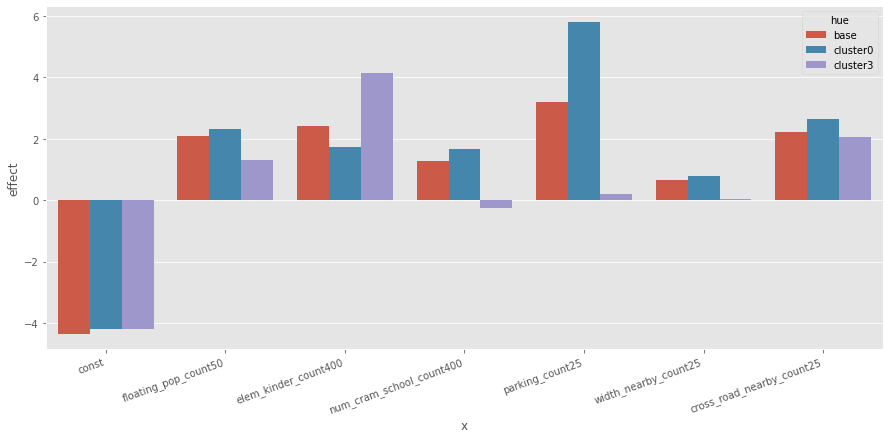

In [26]:
tmp = pd.concat([base_coef.assign(hue="base"),
           cluster0_coef.assign(hue="cluster0"),
           cluster3_coef.assign(hue="cluster3")])
# sns.barplot(data= ,x = "x", y = "effect", hue = "hue")
fig,ax = plt.subplots(figsize = (15,7))
fig.autofmt_xdate(rotation=20)
sns.barplot(data = tmp, x = "x", y = "effect", hue = "hue", ax=ax, )
